In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "1"
# os.chdir('02514-Deep-Learning-In-Computer-Vision/')
# import numpy as np
import glob
import PIL.Image as Image

# pip install torchsummary
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.datasets as datasets
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as transforms
from torchvision import models
from torchsummary import summary
import torch.optim as optim
from time import time
# from dataloader_local import Lesion_Data


import matplotlib.pyplot as plt
from IPython.display import clear_output

print("Running on ", torch.device("cuda" if torch.cuda.is_available() else "cpu"))

Running on  cuda


In [3]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "1"
import numpy as np
import glob
import PIL.Image as Image

# pip install torchsummary
import torch
from torch.utils.data import  random_split
import torchvision.transforms as transforms




data_path_drive = '/dtu/datasets1/02514/DRIVE/training'
data_path_lesion = '/dtu/datasets1/02514/PH2_Dataset_images'

class Lesion_Data(torch.utils.data.Dataset):
    def __init__(self, train_transform_size=128, test_transform_size=128, data_path=data_path_lesion):
        'Initialization'
        self.image_paths = sorted(glob.glob(data_path + '/***/**_Dermoscopic_Image/*.bmp'))
        self.mask_paths = sorted(glob.glob(data_path + '/***/**_lesion/*.bmp'))
        self.train_transform = transforms.Compose([transforms.Resize((train_transform_size, train_transform_size)),
                                                            transforms.ToTensor()])
        self.test_transform = transforms.Compose([transforms.Resize((test_transform_size, test_transform_size)),
                                                            transforms.ToTensor()])

    def __len__(self):
        'Returns the total number of samples'
        return len(self.image_paths)

    def __getitem__(self, idx):
        'Generates one sample of data'
        image_path = self.image_paths[idx]
        mask_path = self.mask_paths[idx]
        image = Image.open(image_path)
        mask = Image.open(mask_path)
        Y = self.train_transform(mask)
        X = self.train_transform(image)
        return X, Y

    def get_datasets(self):
        train_size = int(0.8 * len(self))
        test_size = len(self) - train_size
        val_size = int(0.2 * train_size)
        train_size = train_size - val_size
        train_dataset, test_dataset, val_dataset = random_split(self, [train_size, test_size, val_size])
        train_dataset.dataset.transform = self.train_transform
        test_dataset.dataset.transform = self.test_transform
        val_dataset.dataset.transform = self.test_transform
        return train_dataset, test_dataset, val_dataset

    def get_image_paths(self, train_dataset, test_dataset, val_dataset):
        train_image_paths = [self.image_paths[i] for i in train_dataset.indices]
        test_image_paths = [self.image_paths[i] for i in test_dataset.indices]
        val_image_paths = [self.image_paths[i] for i in val_dataset.indices]

        train_mask_paths = [self.mask_paths[i] for i in train_dataset.indices]
        test_mask_paths = [self.mask_paths[i] for i in test_dataset.indices]
        val_mask_paths = [self.mask_paths[i] for i in val_dataset.indices]

        return train_image_paths, test_image_paths, val_image_paths,train_mask_paths, test_mask_paths, val_mask_paths


In [4]:
torch.cuda.empty_cache()

# Load the data from the first dataset


In [5]:
size = 128
batch_size = 32

dataset = Lesion_Data(train_transform_size=size, test_transform_size=size)
trainset, testset, validationset = dataset.get_datasets()

train_loader = DataLoader(trainset, batch_size=batch_size, shuffle=True, num_workers=3)
test_loader = DataLoader(testset, batch_size=batch_size, shuffle=False, num_workers=3)
validation_loader = DataLoader(validationset, batch_size=batch_size, shuffle=False, num_workers=3)

In [6]:
print('Loaded %d training images' % len(trainset))
print('Loaded %d test images' % len(testset))
print('Loaded %d validation images' % len(validationset))

Loaded 128 training images
Loaded 40 test images
Loaded 32 validation images


In [7]:
##### Every thime we run this, we get new paths, so use the one below
# plt.rcParams['figure.figsize'] = [18, 6]

# images, labels = next(iter(train_loader))

# for i in range(6):
#     plt.subplot(2, 6, i+1)
#     plt.imshow(np.swapaxes(np.swapaxes(images[i], 0, 2), 0, 1))

#     plt.subplot(2, 6, i+7)
#     plt.imshow(labels[i].squeeze())
# plt.show()

In [8]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


## Set cuda device based on the output 

In [9]:
torch.cuda.device('cuda:0')

# Kat segment Anything model comparison 


In [10]:
train_image_paths, test_image_paths, val_image_paths, train_mask_paths, test_mask_paths, val_mask_paths = dataset.get_image_paths(trainset, testset, validationset)
print(test_image_paths[:10])
print(test_mask_paths[:10])

['/dtu/datasets1/02514/PH2_Dataset_images/IMD402/IMD402_Dermoscopic_Image/IMD402.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD022/IMD022_Dermoscopic_Image/IMD022.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD160/IMD160_Dermoscopic_Image/IMD160.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD199/IMD199_Dermoscopic_Image/IMD199.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD280/IMD280_Dermoscopic_Image/IMD280.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD173/IMD173_Dermoscopic_Image/IMD173.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD367/IMD367_Dermoscopic_Image/IMD367.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD393/IMD393_Dermoscopic_Image/IMD393.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD406/IMD406_Dermoscopic_Image/IMD406.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD426/IMD426_Dermoscopic_Image/IMD426.bmp']
['/dtu/datasets1/02514/PH2_Dataset_images/IMD402/IMD402_lesion/IMD402_lesion.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD022/IMD022_l

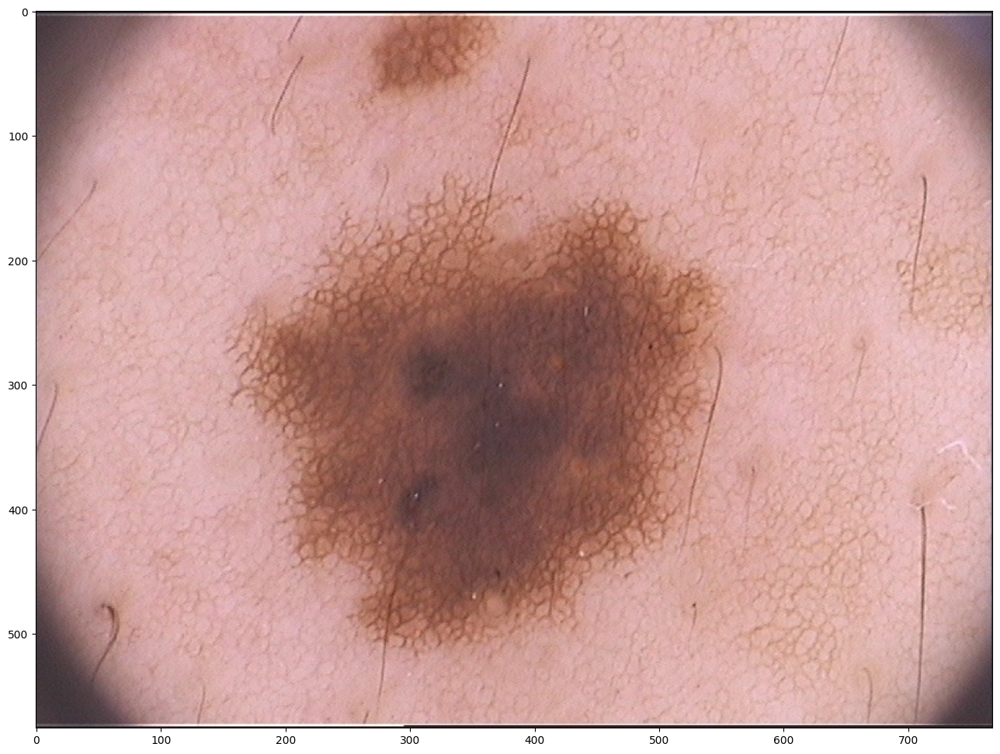

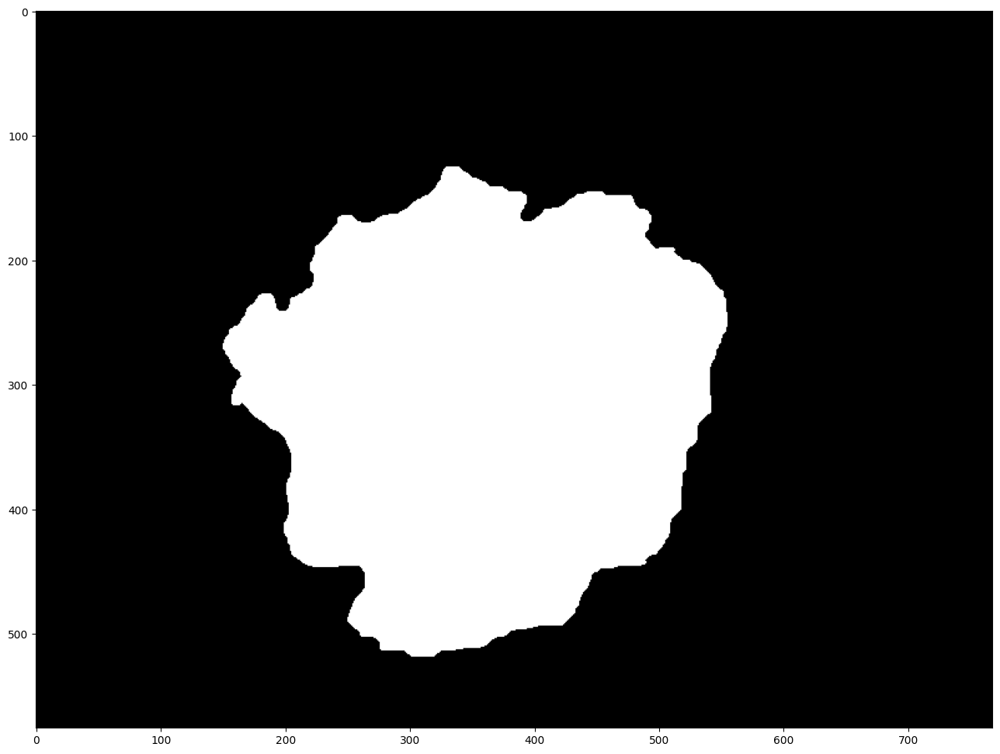

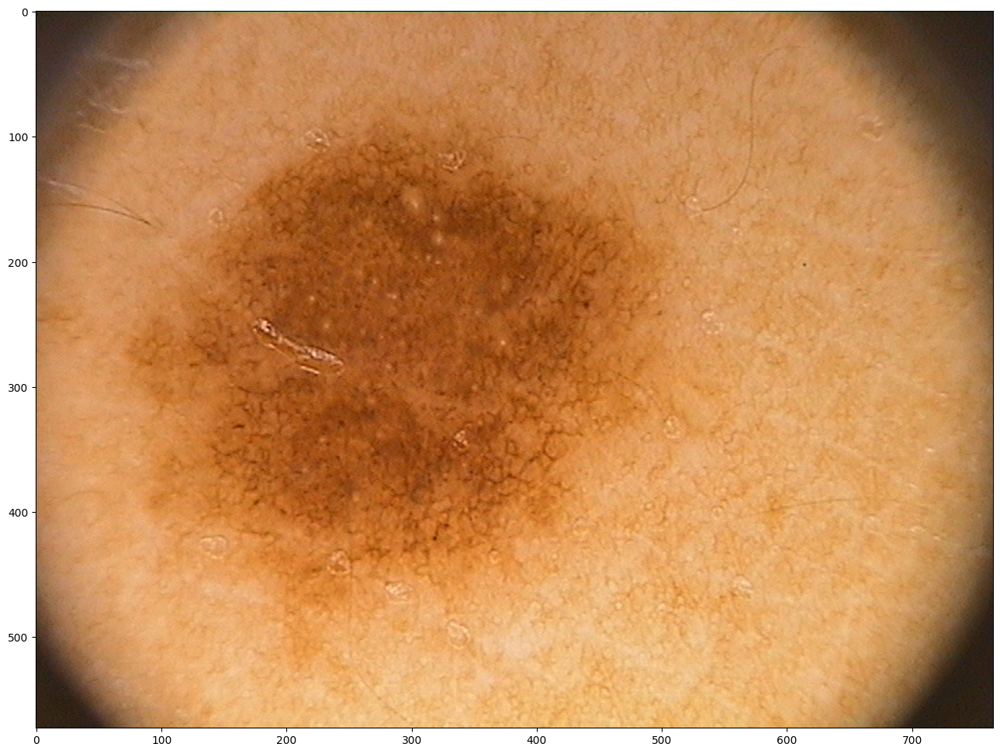

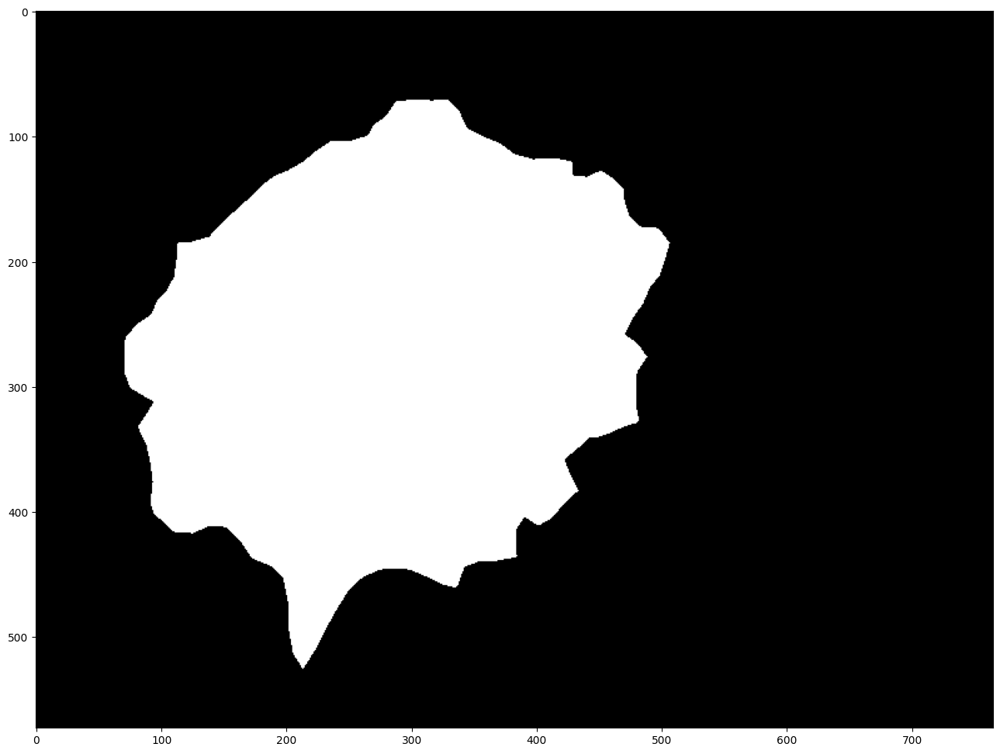

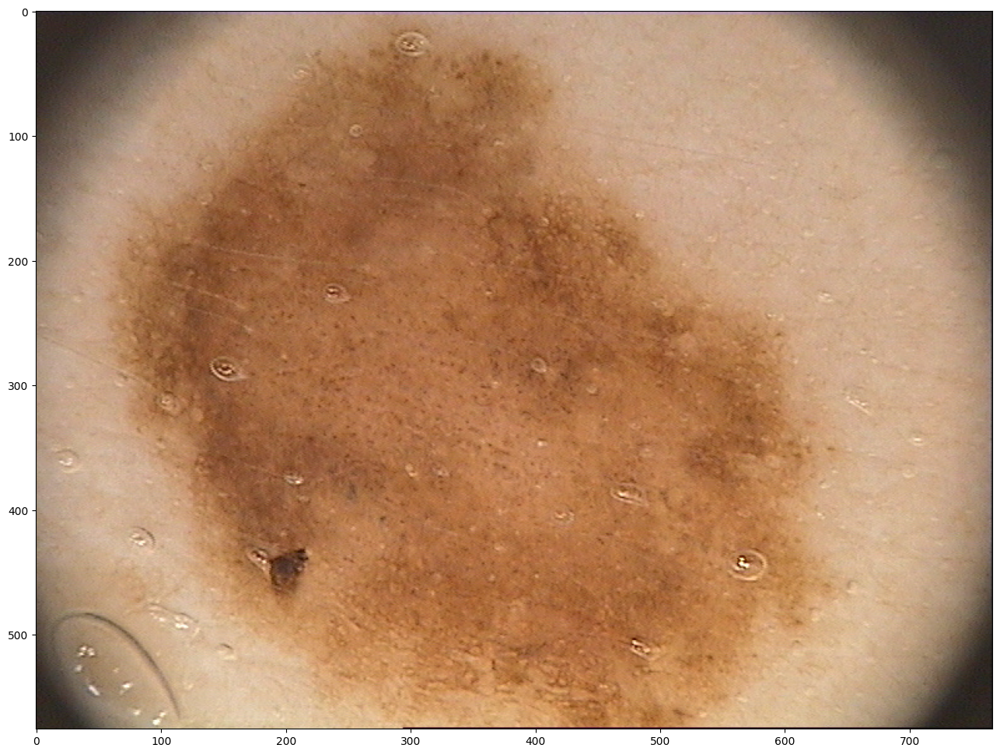

...

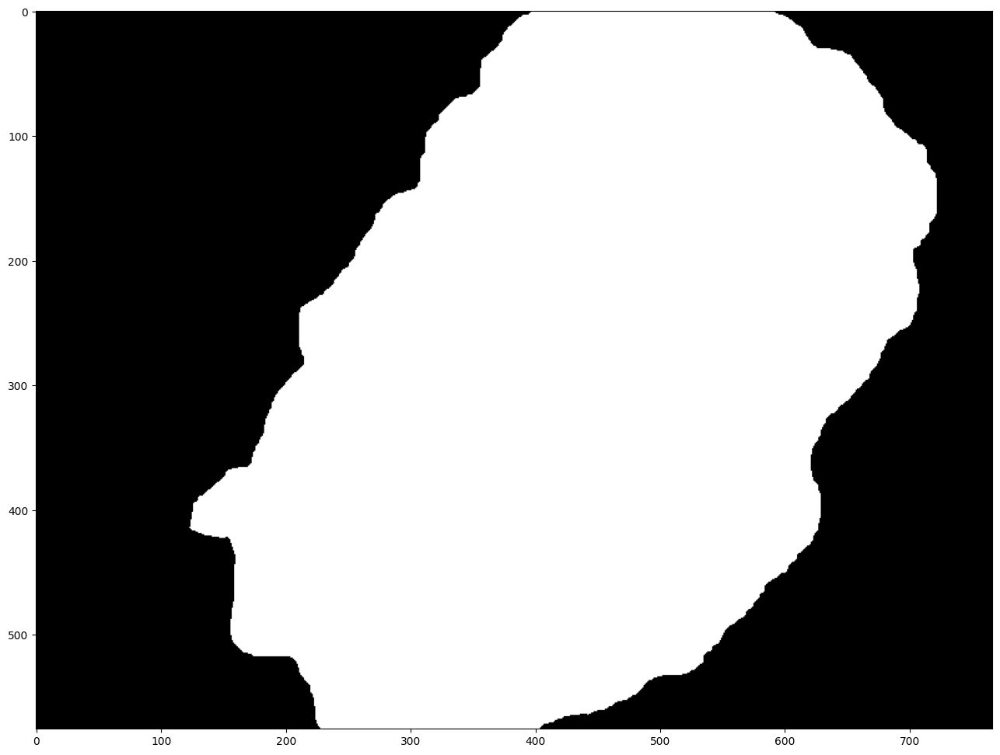

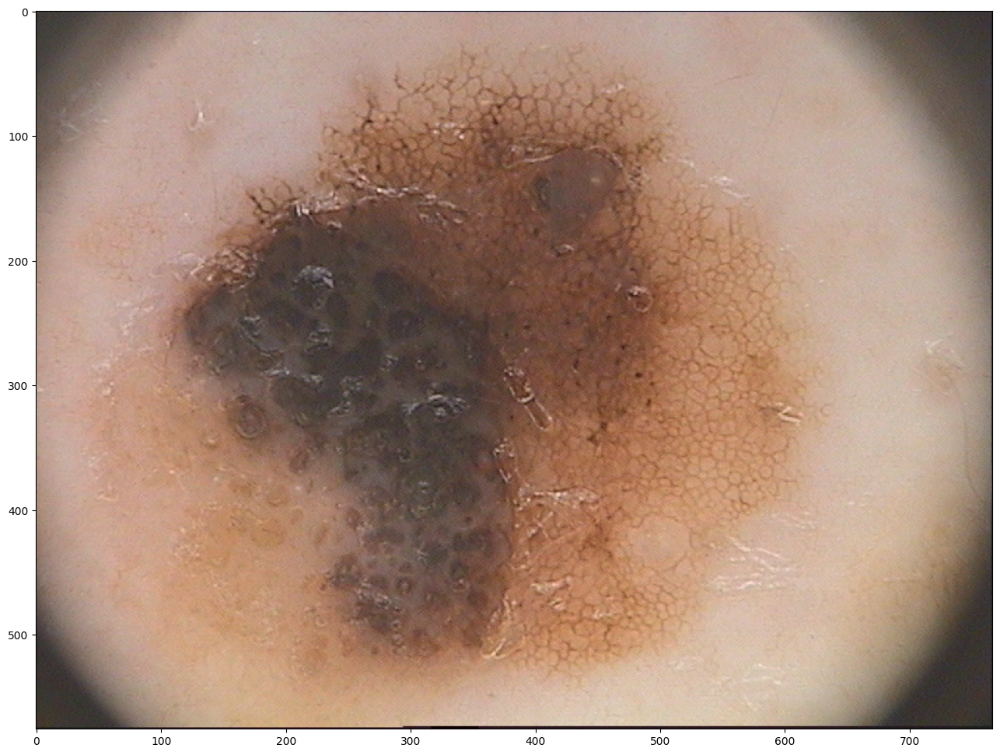

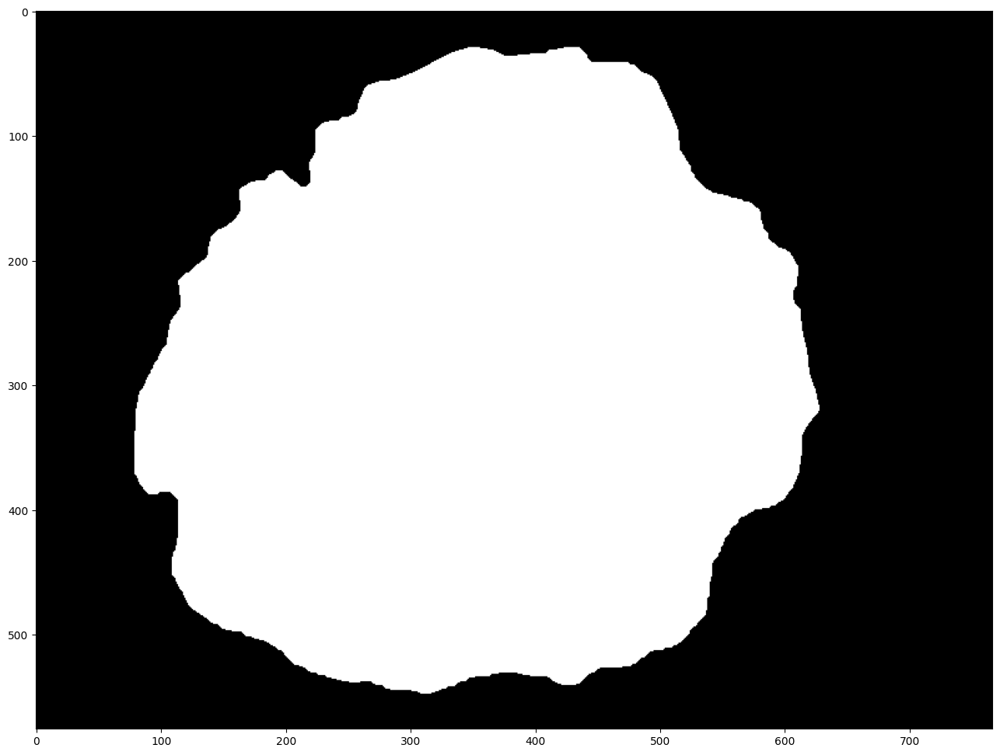

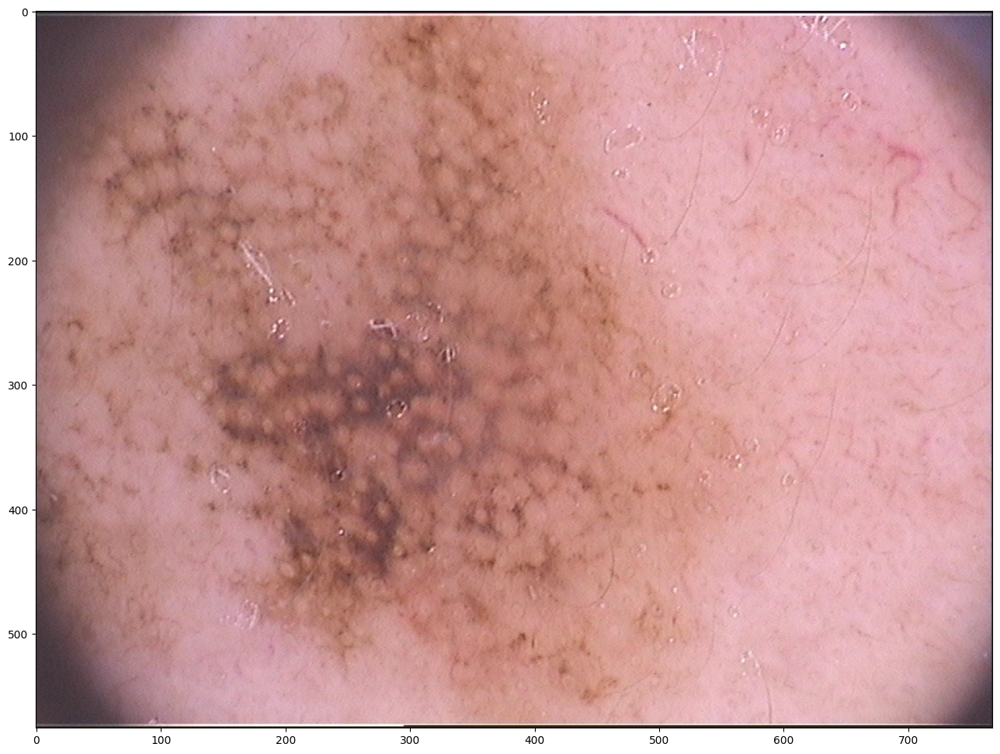

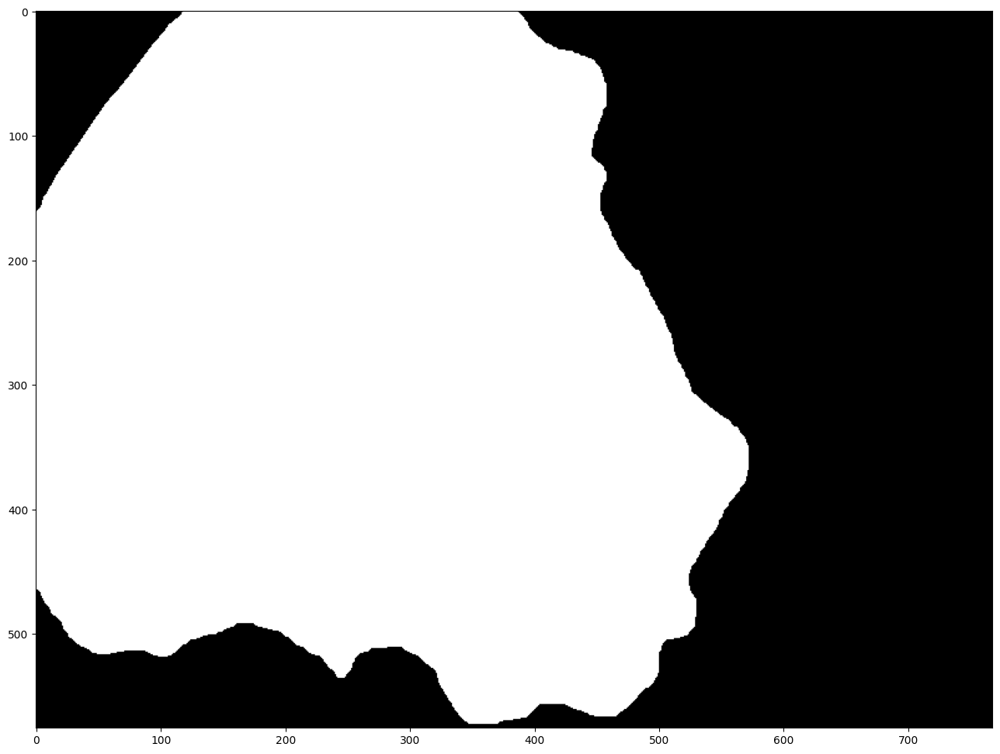

In [20]:
# visualise the testdata corresponding to the paths

plt.rcParams['figure.figsize'] = [35, 12]
for i in range(10):
    # subplot = plt.subplot(2, 6, i+1+2)
    image = Image.open(test_image_paths[i])

    plt.imshow(image)
    plt.show()


    # subplot = plt.subplot(2, 6, i+7+2)
    image = Image.open(test_mask_paths[i].replace('Dermoscopic_Image', 'lesion'))

    plt.imshow(image)
    plt.show()


# Paths

In [16]:
['/dtu/datasets1/02514/PH2_Dataset_images/IMD402/IMD402_Dermoscopic_Image/IMD402.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD022/IMD022_Dermoscopic_Image/IMD022.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD160/IMD160_Dermoscopic_Image/IMD160.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD199/IMD199_Dermoscopic_Image/IMD199.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD280/IMD280_Dermoscopic_Image/IMD280.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD173/IMD173_Dermoscopic_Image/IMD173.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD367/IMD367_Dermoscopic_Image/IMD367.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD393/IMD393_Dermoscopic_Image/IMD393.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD406/IMD406_Dermoscopic_Image/IMD406.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD426/IMD426_Dermoscopic_Image/IMD426.bmp']
# ['/dtu/datasets1/02514/PH2_Dataset_images/IMD402/IMD402_lesion/IMD402_lesion.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD022/IMD022_lesion/IMD022_lesion.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD160/IMD160_lesion/IMD160_lesion.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD199/IMD199_lesion/IMD199_lesion.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD280/IMD280_lesion/IMD280_lesion.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD173/IMD173_lesion/IMD173_lesion.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD367/IMD367_lesion/IMD367_lesion.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD393/IMD393_lesion/IMD393_lesion.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD406/IMD406_lesion/IMD406_lesion.bmp', '/dtu/datasets1/02514/PH2_Dataset_images/IMD426/IMD426_lesion/IMD426_lesion.bmp']

['/dtu/datasets1/02514/PH2_Dataset_images/IMD402/IMD402_Dermoscopic_Image/IMD402.bmp',
 '/dtu/datasets1/02514/PH2_Dataset_images/IMD022/IMD022_Dermoscopic_Image/IMD022.bmp',
 '/dtu/datasets1/02514/PH2_Dataset_images/IMD160/IMD160_Dermoscopic_Image/IMD160.bmp',
 '/dtu/datasets1/02514/PH2_Dataset_images/IMD199/IMD199_Dermoscopic_Image/IMD199.bmp',
 '/dtu/datasets1/02514/PH2_Dataset_images/IMD280/IMD280_Dermoscopic_Image/IMD280.bmp',
 '/dtu/datasets1/02514/PH2_Dataset_images/IMD173/IMD173_Dermoscopic_Image/IMD173.bmp',
 '/dtu/datasets1/02514/PH2_Dataset_images/IMD367/IMD367_Dermoscopic_Image/IMD367.bmp',
 '/dtu/datasets1/02514/PH2_Dataset_images/IMD393/IMD393_Dermoscopic_Image/IMD393.bmp',
 '/dtu/datasets1/02514/PH2_Dataset_images/IMD406/IMD406_Dermoscopic_Image/IMD406.bmp',
 '/dtu/datasets1/02514/PH2_Dataset_images/IMD426/IMD426_Dermoscopic_Image/IMD426.bmp']